весь код и файлы:

https://github.com/kopch02/semestr6/tree/master/ML/lab12

In [1]:
import cv2
import numpy as np 
import os
import matplotlib.pyplot as plt

In [2]:
face_cascade = cv2.CascadeClassifier('model/haarcascade_frontalface_default.xml')
face_profile_cascade = cv2.CascadeClassifier('model/haarcascade_profileface.xml')

In [3]:
def face_det_cv2(photo_name):
    img = cv2.imread(photo_name)
    #img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Для детекции нужно сделать изображение черно-белым
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Детектируем лица в анфас
    faces = face_cascade.detectMultiScale(gray, 1.1, 5, minSize=(200, 200)) # 1.1 и 5 - это гиперпараметры, их перебор позволяет регулировать детекцию
    # Нарисуем зеленые прямоугольники вокруг лиц.
    for (x, y, w, h) in faces:
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 255, 0), 5)

    # проверим лица в профиль
    faces = face_profile_cascade.detectMultiScale(gray, 1.1, 3, minSize=(200, 200))
    # Нарисуем прямоугольники вокруг лиц.
    for (x, y, w, h) in faces:
        cv2.rectangle(img, (x, y), (x+w, y+h), (0, 255, 0), 5)
    # Посмотрим что получилось
    plt.figure(figsize=(8,8), dpi=90)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()


In [22]:
photos = list(filter(lambda x : '.jpg' in x, os.listdir("img")))
photos

['1.jpg',
 '2.jpg',
 '3.jpg',
 '4.jpg',
 '5.jpg',
 '6.jpg',
 '7.jpg',
 'bilan.jpg',
 'hathaway.jpg',
 'hathaway2.jpg',
 'holland.jpg',
 'ilon.jpg',
 'ilon2.jpg',
 'lazarev.jpg']

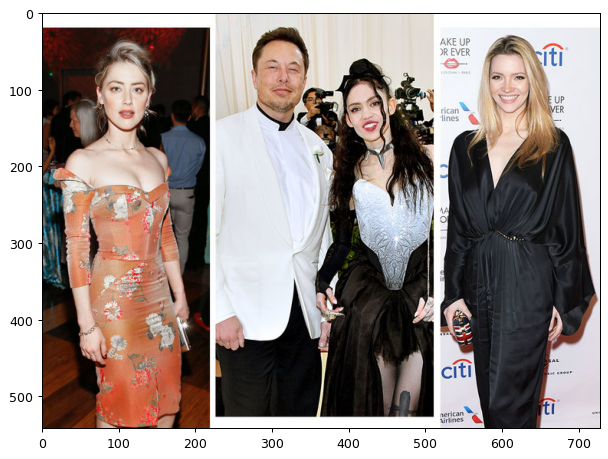

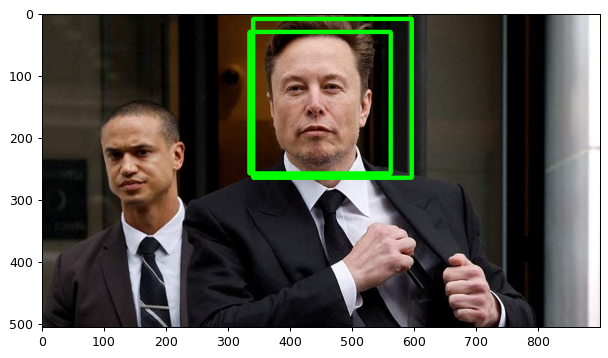

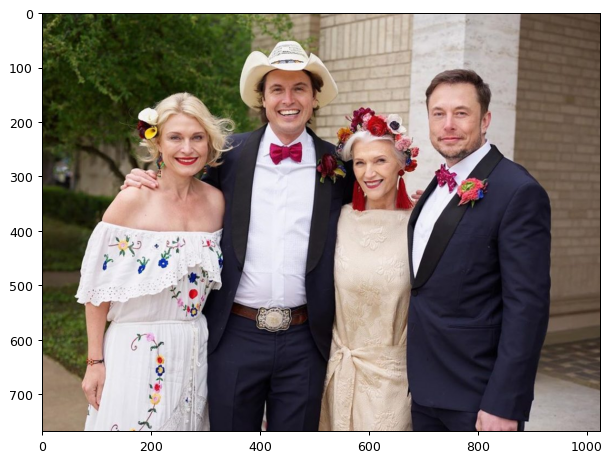

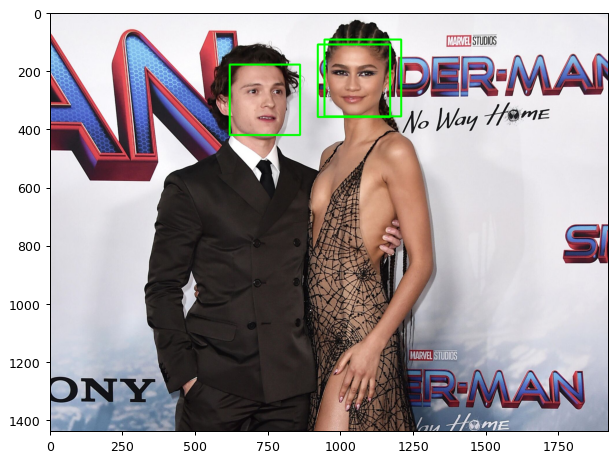

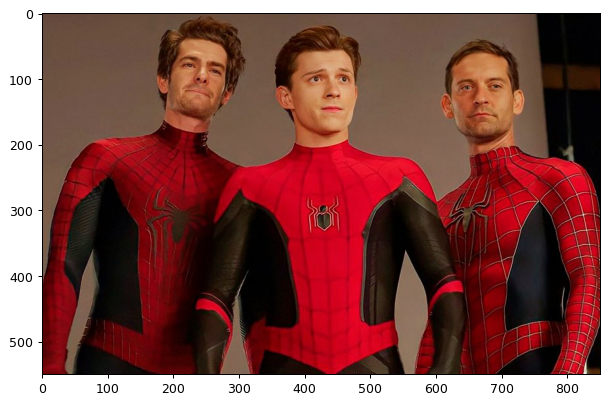

...

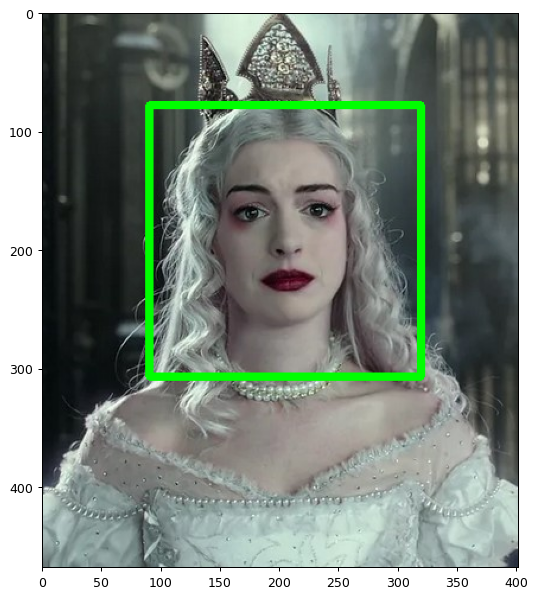

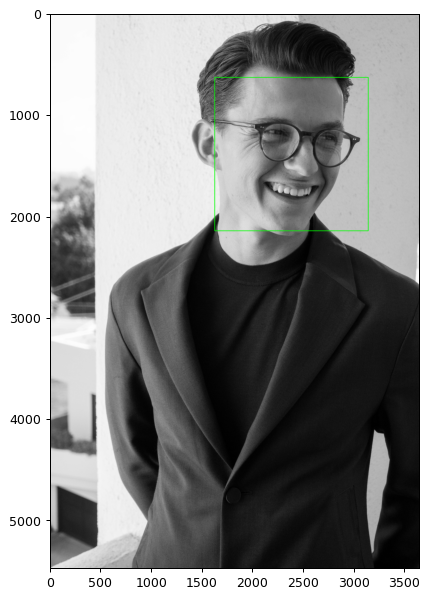

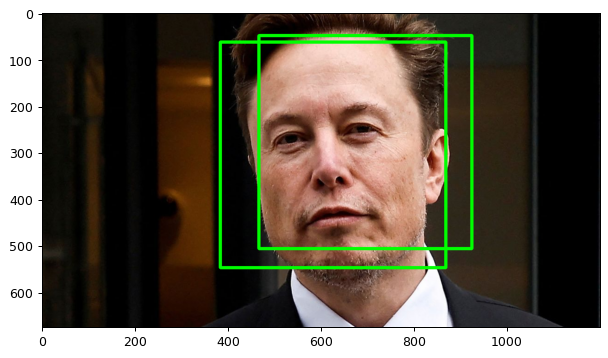

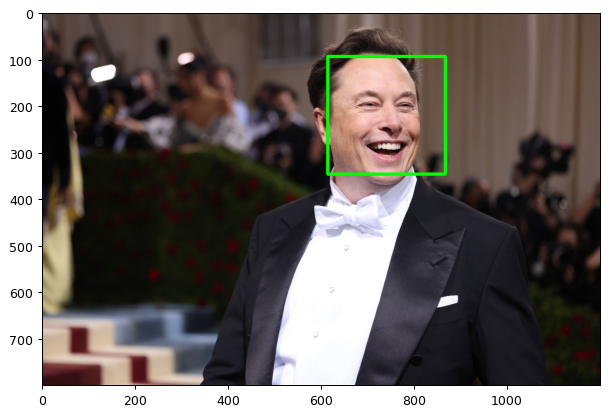

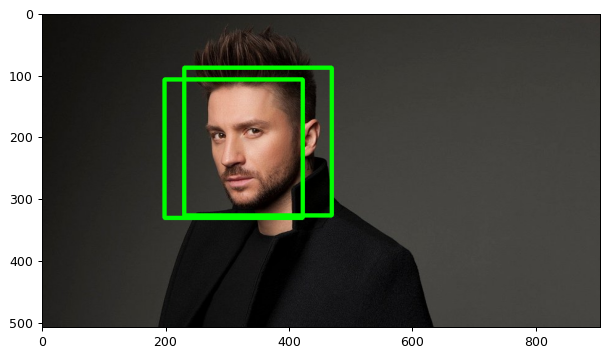

In [23]:
for photo in photos:
    face_det_cv2("img/" + photo)

In [13]:
import face_recognition

In [15]:
def face_det_fr(photo_name):
    image_processed = face_recognition.load_image_file(photo_name)
    print(type(image_processed))
    face_location = face_recognition.face_locations(image_processed)
    img = cv2.imread(photo_name)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for (top, right, bottom, left) in (face_location):
        cv2.rectangle(img, (left, top), (right, bottom), (0, 255, 0), 5)
    # Посмотрим что получилось
    plt.figure(figsize=(8,8), dpi=90)
    plt.imshow(img)
    plt.show()

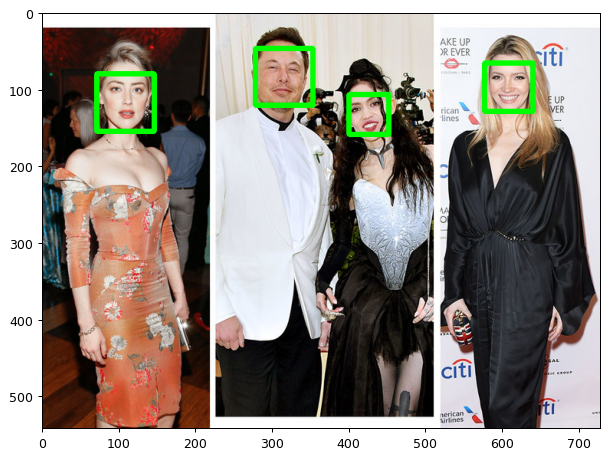

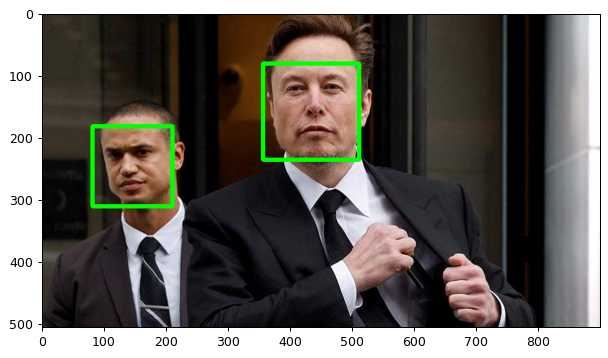

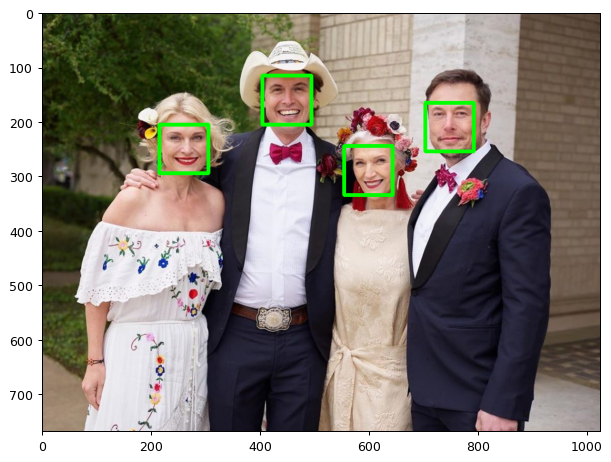

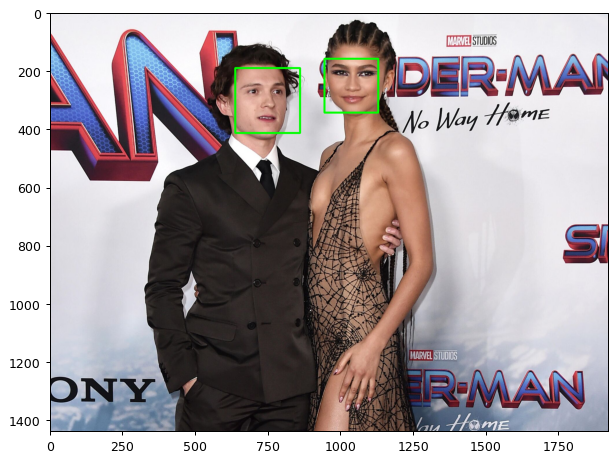

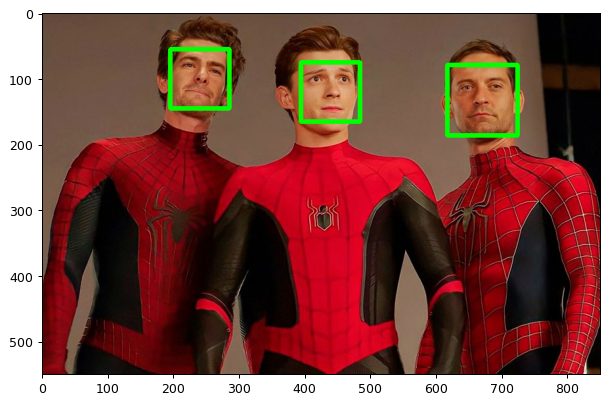

...

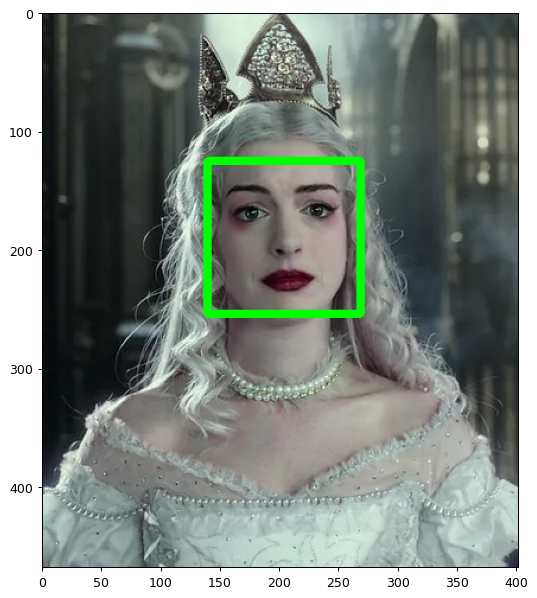

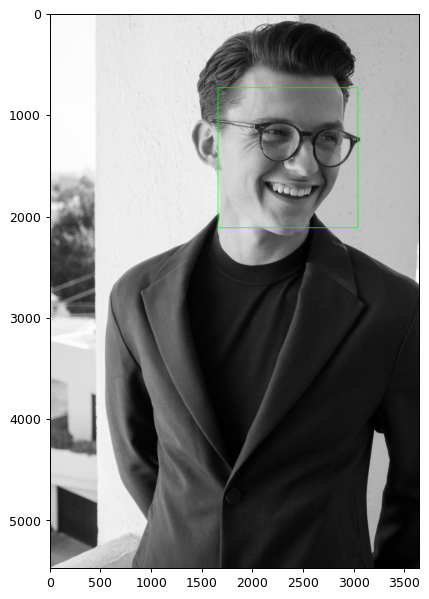

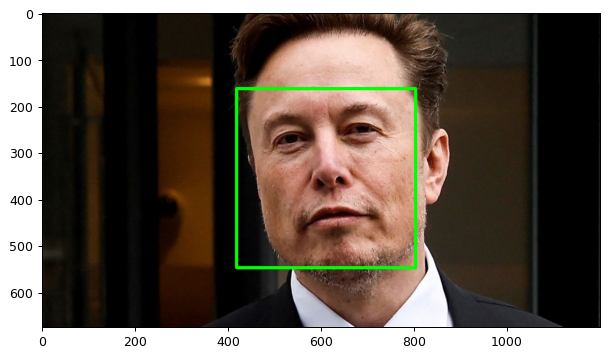

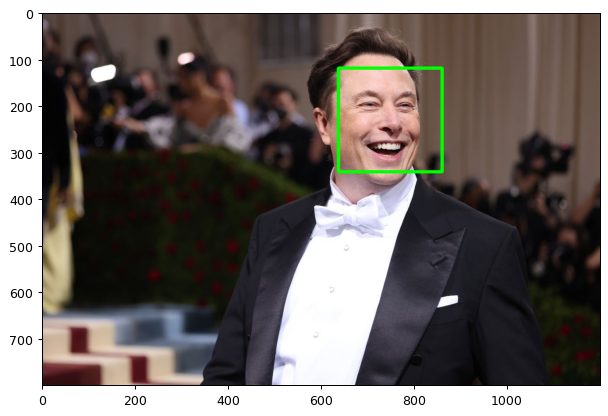

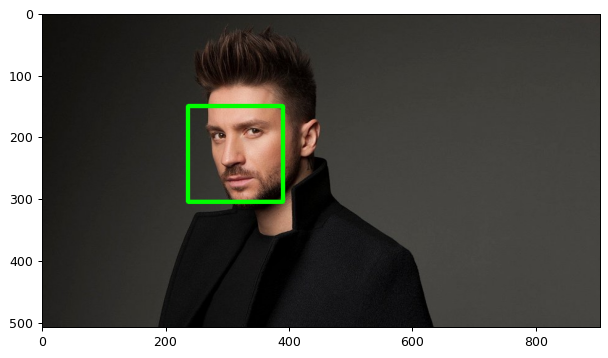

In [28]:
for photo in photos:
    face_det_fr("img/" + photo)

In [29]:
from mtcnn import MTCNN

In [30]:
def face_det_mtcnn(photo_name):
    img = cv2.imread(photo_name)
    detector = MTCNN()

    face_list = detector.detect_faces(img) # face detect and alignment

    for face in face_list:
        box = face["box"]
        keypoints = face["keypoints"]

        # draw boundingbox
        x,y,w,h = box
        cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0),5)

        # draw keypoints
        cv2.circle(img,keypoints["left_eye"],1,(0,0,255),5)
        cv2.circle(img,keypoints["right_eye"],1,(0,0,255),5)
        cv2.circle(img,keypoints["nose"],1,(0,0,255),5)
        cv2.circle(img,keypoints["mouth_left"],1,(0,0,255),5)
        cv2.circle(img,keypoints["mouth_right"],1,(0,0,255),5)
    
    # Посмотрим что получилось
    plt.figure(figsize=(8,8), dpi=90)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

1/1 [==============================] - 0s 168ms/step


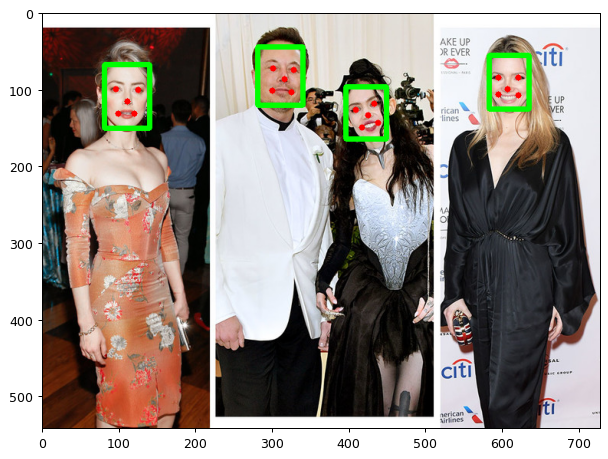

1/1 [==============================] - 0s 161ms/step


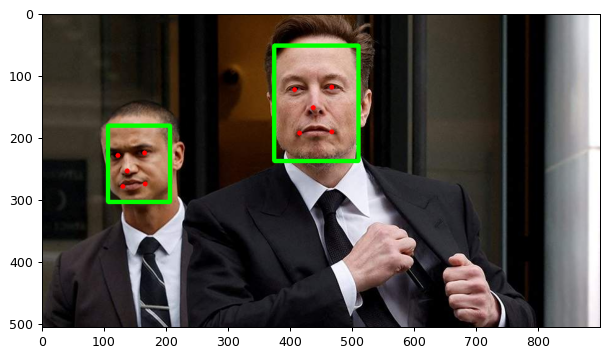

1/1 [==============================] - 0s 151ms/step


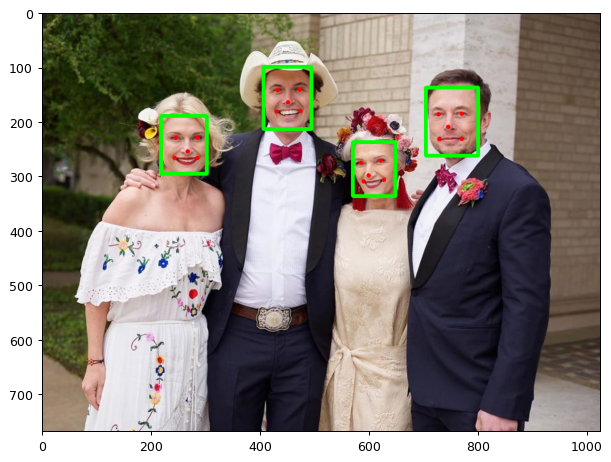

1/1 [==============================] - 0s 153ms/step


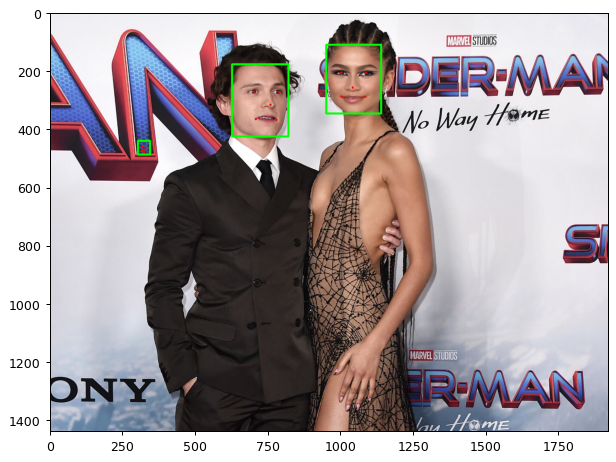

1/1 [==============================] - 0s 143ms/step


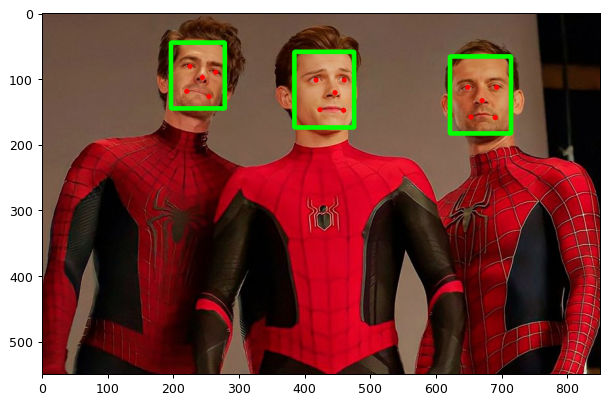

1/1 [==============================] - 0s 146ms/step


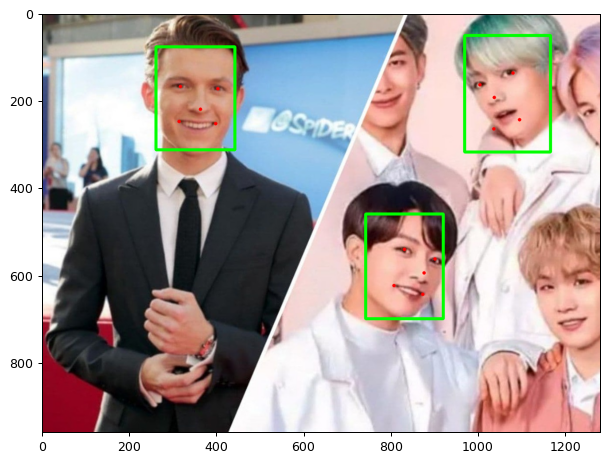

1/1 [==============================] - 0s 147ms/step


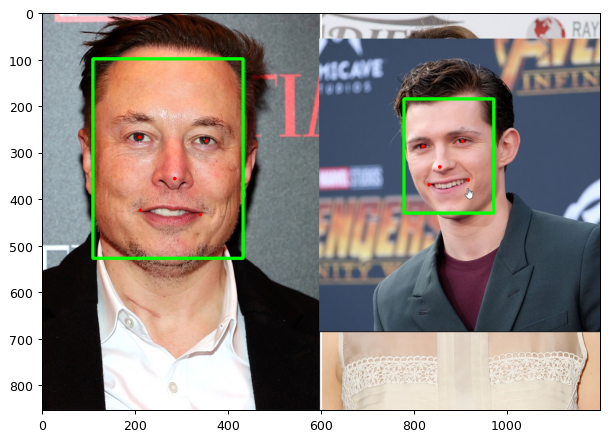

1/1 [==============================] - 0s 146ms/step


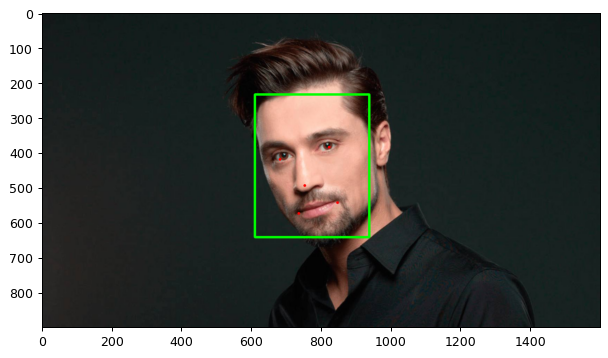

1/1 [==============================] - 0s 140ms/step


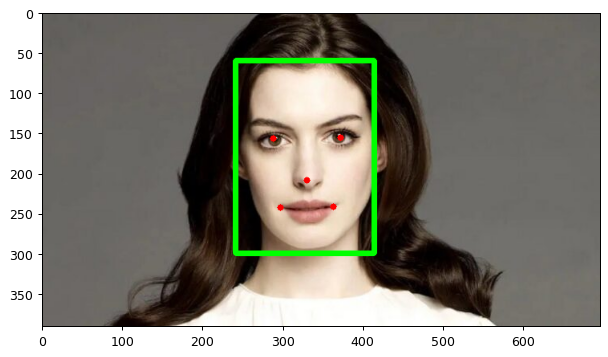

1/1 [==============================] - 0s 139ms/step


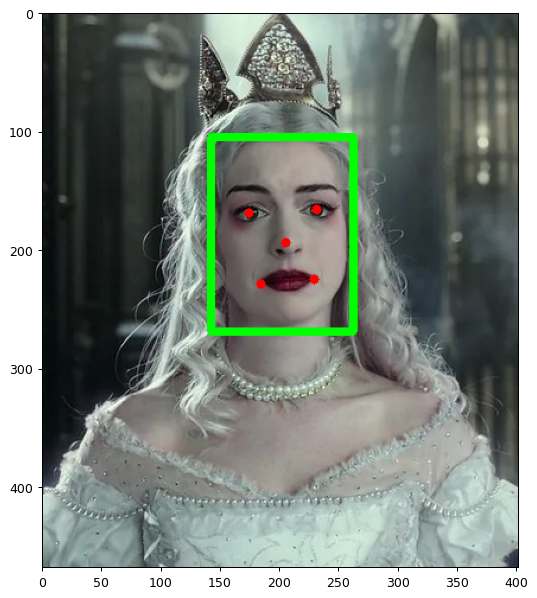

1/1 [==============================] - 0s 150ms/step


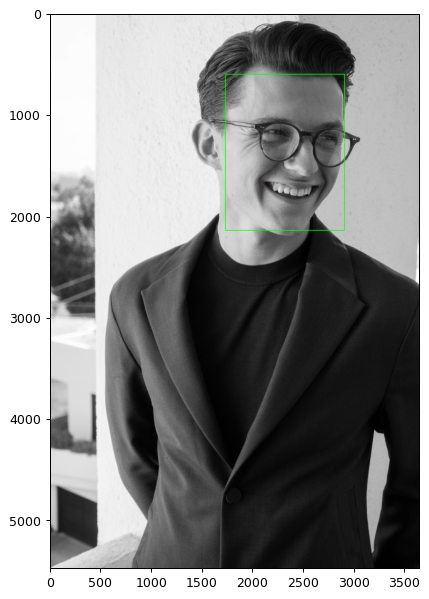

1/1 [==============================] - 0s 147ms/step


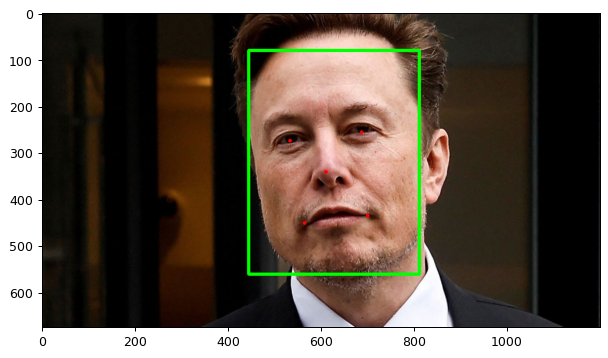

1/1 [==============================] - 0s 145ms/step


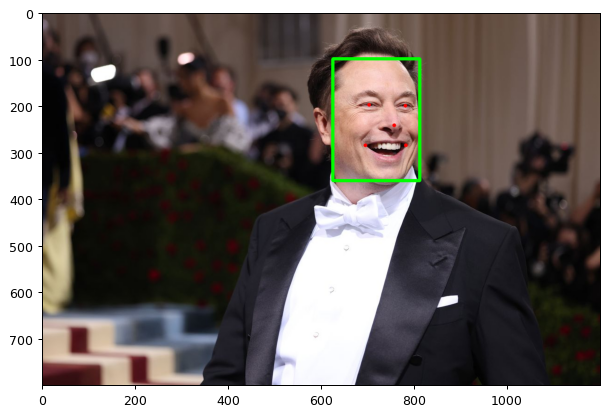

1/1 [==============================] - 0s 145ms/step


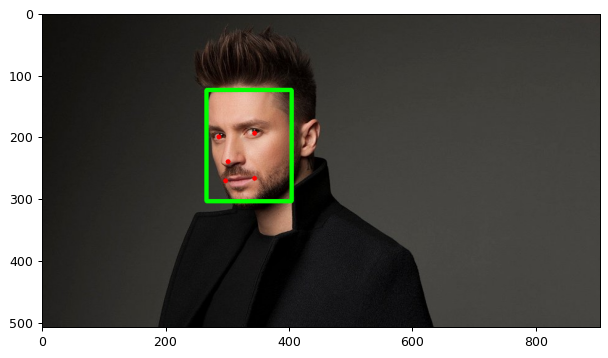

In [31]:
for photo in photos:
    face_det_mtcnn("img/" + photo)

In [13]:
import cv2
import numpy as np
import face_recognition
face_cascade = cv2.CascadeClassifier('model/haarcascade_frontalface_default.xml')
face_profile_cascade = cv2.CascadeClassifier('model/haarcascade_profileface.xml')

вариант с вебки

In [5]:
video_capture = cv2.VideoCapture(0)

# Load a sample picture and learn how to recognize it.


# Load a second sample picture and learn how to recognize it.
biden_image = face_recognition.load_image_file("Marat.jpg")
biden_face_encoding = face_recognition.face_encodings(biden_image)[0]

# Create arrays of known face encodings and their names
known_face_encodings = [
    biden_face_encoding,
]
known_face_names = [
    "Marat",
]

while True:
    # Grab a single frame of video
    ret, frame = video_capture.read()

    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    #rgb_frame = frame[:, :, ::-1]

    # Find all the faces and face enqcodings in the frame of video
    face_locations = face_recognition.face_locations(frame)
    face_encodings = face_recognition.face_encodings(frame, face_locations)

    # Loop through each face in this frame of video
    for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
        # See if the face is a match for the known face(s)
        matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

        name = "Unknown"

        # If a match was found in known_face_encodings, just use the first one.
        # if True in matches:
        #     first_match_index = matches.index(True)
        #     name = known_face_names[first_match_index]

        # Or instead, use the known face with the smallest distance to the new face
        face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
        best_match_index = np.argmin(face_distances)
        if matches[best_match_index]:
            name = known_face_names[best_match_index]

        # Draw a box around the face
        cv2.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), 2)

        # Draw a label with a name below the face
        cv2.rectangle(frame, (left, bottom - 35), (right, bottom), (0, 0, 255), cv2.FILLED)
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, name, (left + 6, bottom - 6), font, 1.0, (255, 255, 255), 1)

    # Display the resulting image
    cv2.imshow('Video', frame)

    # Hit 'q' on the keyboard to quit!
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release handle to the webcam
video_capture.release()
cv2.destroyAllWindows()

вариант с видео

In [14]:
from base64 import b64encode
from IPython.display import HTML

In [15]:
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [16]:
input_video = "video.mp4"
input_movie = cv2.VideoCapture(input_video)
length = int(input_movie.get(cv2.CAP_PROP_FRAME_COUNT))
length

341

In [17]:
video_capture = cv2.VideoCapture('video.mp4')
width = int(video_capture.get(3))
height = int(video_capture.get(4))
frame_rate = int(video_capture.get(cv2.CAP_PROP_FPS))
fourcc = cv2.VideoWriter_fourcc(*'XVID')
output_movie = cv2.VideoWriter('output.avi', fourcc, frame_rate, (width, height))

frame_number = 0

known_face_encodings = []
    
known_face_names = [
    "Marat",
]

for name in known_face_names:
    biden_image = face_recognition.load_image_file(f"{name}.jpg")
    biden_face_encoding = face_recognition.face_encodings(biden_image)[0]
    known_face_encodings.append(biden_face_encoding)

while True:
    # Grab a single frame of video
    ret, frame = video_capture.read()
    frame_number += 1
    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    #rgb_frame = frame[:, :, ::-1]
    
    if not ret:
        break

    # Find all the faces and face enqcodings in the frame of video
    face_locations = face_recognition.face_locations(frame)
    face_encodings = face_recognition.face_encodings(frame, face_locations)

    # Loop through each face in this frame of video
    for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
        # See if the face is a match for the known face(s)
        matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

        name = "Unknown"

        # If a match was found in known_face_encodings, just use the first one.
        # if True in matches:
        #     first_match_index = matches.index(True)
        #     name = known_face_names[first_match_index]

        # Or instead, use the known face with the smallest distance to the new face
        face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
        best_match_index = np.argmin(face_distances)
        if matches[best_match_index]:
            name = known_face_names[best_match_index]

        # Draw a box around the face
        cv2.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), 2)

        # Draw a label with a name below the face
        cv2.rectangle(frame, (left, bottom - 35), (right, bottom), (0, 0, 255), cv2.FILLED)
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, name, (left + 6, bottom - 6), font, 1.0, (255, 255, 255), 1)
    
    print("Writing frame {} / {}".format(frame_number, length))
    output_movie.write(frame)


Writing frame 1 / 341
Writing frame 2 / 341
Writing frame 3 / 341
Writing frame 4 / 341
Writing frame 5 / 341
Writing frame 6 / 341
Writing frame 7 / 341
Writing frame 8 / 341
Writing frame 9 / 341
Writing frame 10 / 341
Writing frame 11 / 341
Writing frame 12 / 341
Writing frame 13 / 341
Writing frame 14 / 341
Writing frame 15 / 341
Writing frame 16 / 341
Writing frame 17 / 341
Writing frame 18 / 341
Writing frame 19 / 341
Writing frame 20 / 341
Writing frame 21 / 341
Writing frame 22 / 341
Writing frame 23 / 341
Writing frame 24 / 341
Writing frame 25 / 341
Writing frame 26 / 341
Writing frame 27 / 341
Writing frame 28 / 341
Writing frame 29 / 341
Writing frame 30 / 341
Writing frame 31 / 341
Writing frame 32 / 341
Writing frame 33 / 341
Writing frame 34 / 341
Writing frame 35 / 341
Writing frame 36 / 341
Writing frame 37 / 341
Writing frame 38 / 341
Writing frame 39 / 341
Writing frame 40 / 341
Writing frame 41 / 341
Writing frame 42 / 341
Writing frame 43 / 341
Writing frame 44 / 3

In [18]:
!ffmpeg -i output.avi output.mp4

ffmpeg version n5.1.2-9-g807afa59cc-20221219 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 12.2.0 (crosstool-NG 1.25.0.90_cf9beb1)
  configuration: --prefix=/ffbuild/prefix --pkg-config-flags=--static --pkg-config=pkg-config --cross-prefix=x86_64-w64-mingw32- --arch=x86_64 --target-os=mingw32 --enable-gpl --enable-version3 --disable-debug --disable-w32threads --enable-pthreads --enable-iconv --enable-libxml2 --enable-zlib --enable-libfreetype --enable-libfribidi --enable-gmp --enable-lzma --enable-fontconfig --enable-libvorbis --enable-opencl --disable-libpulse --enable-libvmaf --disable-libxcb --disable-xlib --enable-amf --enable-libaom --enable-libaribb24 --enable-avisynth --disable-chromaprint --enable-libdav1d --enable-libdavs2 --disable-libfdk-aac --enable-ffnvcodec --enable-cuda-llvm --enable-frei0r --enable-libgme --enable-libkvazaar --enable-libass --enable-libbluray --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librist --enable-libssh --enable-

In [19]:
mp4 = open('output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)